In [145]:
import librosa
import os
import numpy as np
from IPython.display import Audio
import mir_eval.sonify

path = '../data/lazy-vocal.mp3'
assert os.path.exists(path), "The file does not exist."

y, sr = librosa.load(path)

print(sr)

/usr/local/lib/python3.9/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)


22050


In [146]:
num_secs = 15
index = 15 * 22050
audio_slice = y[0:index]

print(index)

330750


In [66]:
Audio(data=audio_slice, rate=sr)

In [71]:
times = []
for i in range(len(audio_slice)):
    time = i/22050
    times.append(time)

Text(0, 0.5, 'Signal (Hz)')

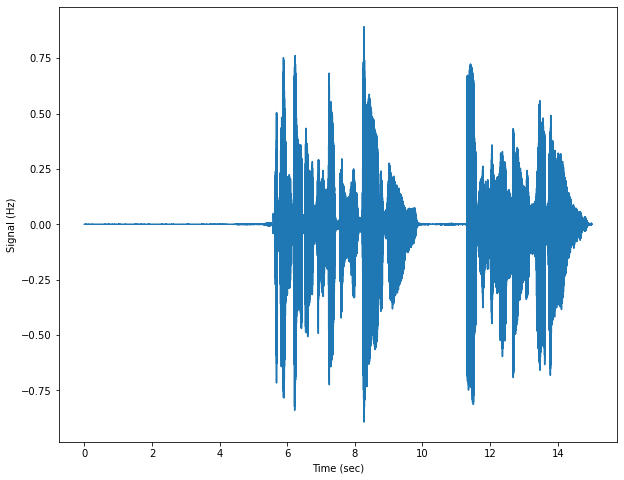

In [86]:
plt.figure(figsize=(10, 8))
plt.plot(times,audio_slice)
plt.xlabel('Time (sec)')
plt.ylabel('Signal (Hz)')

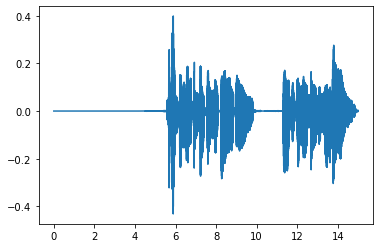

In [79]:
def smooth(scalars, weight):  # Weight between 0 and 1
    last = scalars[0]  # First value in the plot (first timestep)
    smoothed = list()
    for point in scalars:
        smoothed_val = last * weight + (1 - weight) * point  # Calculate smoothed value
        smoothed.append(smoothed_val)                        # Save it
        last = smoothed_val                                  # Anchor the last smoothed value
        
    return smoothed


plt.plot(times, smooth(audio_slice, .9))

In [102]:
mean = np.mean(audio_slice)
median = np.median(audio_slice)
std_dev = np.std(audio_slice)

print("mean:", mean)
print("median:", median)
print("std dev:", std_dev)

binary_audio = []
for i in range(len(audio_slice)):
    s = audio_slice[i]
    if s < mean-(2*std_dev):
        #print(times[i])
        binary_audio.append(0)
    else:
        binary_audio.append(1)

mean: -7.006801e-07
median: 1.84501e-06
std dev: 0.09338153


Text(0, 0.5, 'Signal (Hz)')

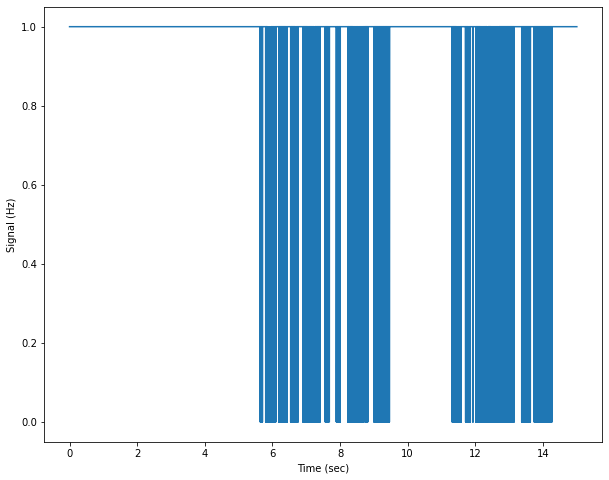

In [103]:
plt.figure(figsize=(10, 8))
plt.plot(times, binary_audio)
plt.xlabel('Time (sec)')
plt.ylabel('Signal (Hz)')

In [113]:
time_sig = []
for i in range(len(binary_audio)):
    #time_dic = {}
    sig = binary_audio[i]
    if i == 0:
        start = times[i]
        prev_sig = sig
    if sig != prev_sig:
        end = times[i]
        t_range = (start,end,sig)
        #time_dic[t_range] = sig
        time_sig.append(t_range)
        start = end
    prev_sig = sig

In [114]:
print(time_sig)

[(0.0, 5.6380952380952385, 0), (5.6380952380952385, 5.638140589569161, 1), (5.638140589569161, 5.638956916099773, 0), (5.638956916099773, 5.639002267573696, 1), (5.639002267573696, 5.648027210884353, 0), (5.648027210884353, 5.648072562358276, 1), (5.648072562358276, 5.64875283446712, 0), (5.64875283446712, 5.648798185941043, 1), (5.648798185941043, 5.648888888888889, 0), (5.648888888888889, 5.648934240362812, 1), (5.648934240362812, 5.649070294784581, 0), (5.649070294784581, 5.649115646258504, 1), (5.649115646258504, 5.649297052154195, 0), (5.649297052154195, 5.649342403628118, 1), (5.649342403628118, 5.664625850340136, 0), (5.664625850340136, 5.664671201814059, 1), (5.664671201814059, 5.664761904761905, 0), (5.664761904761905, 5.664852607709751, 1), (5.664852607709751, 5.664943310657597, 0), (5.664943310657597, 5.665079365079365, 1), (5.665079365079365, 5.665124716553288, 0), (5.665124716553288, 5.665215419501134, 1), (5.665215419501134, 5.66530612244898, 0), (5.66530612244898, 5.6653

In [143]:
time_bins = []
old_start = 0
idx = 0
found = False
for i in range(len(time_sig)-1):
    old_start,old_end,old_sig = time_sig[idx]
    old_gap = old_end-old_start
    while not found:
        new_start,new_end,new_sig = time_sig[idx]
        new_gap = new_end-new_start
        if new_gap > .3:
            found = True
        idx += 1      

In [144]:
#print(time_bins)
print(len(time_sig))
print(len(time_bins))

5940
5939


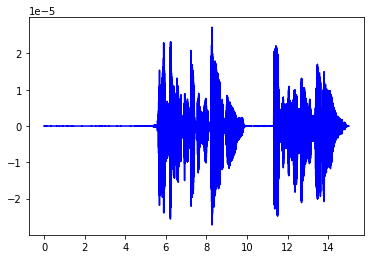

In [91]:
pow_audio_signal = audio_slice / np.power(2, 15)
pow_audio_signal = pow_audio_signal
plt.plot(times, pow_audio_signal, color='blue')

In [92]:
for x in pow_audio_signal:
    if x == 0:
        print(x)

In [40]:
hop_length = 200 # samples per frame
onset_env = librosa.onset.onset_strength(y, sr=sr, hop_length=hop_length, n_fft=2048)

/var/folders/42/8_0pl3sd13zgt0n9z_j4_5sm0000gr/T/ipykernel_61368/823550262.py:2: FutureWarning: Pass y=[-5.5549149e-06  3.5650048e-06  8.9982768e-06 ...  3.9009848e-07
  7.3793908e-06  0.0000000e+00] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  onset_env = librosa.onset.onset_strength(y, sr=sr, hop_length=hop_length, n_fft=2048)


In [41]:
frames = range(len(onset_env))
t = librosa.frames_to_time(frames, sr=sr, hop_length=hop_length)

In [42]:
import sys
sys.path.append('/Users/sdkolak/anaconda3/envs/hector/lib/python3.9/site-packages')

Text(0.5, 1.0, 'Novelty Function')

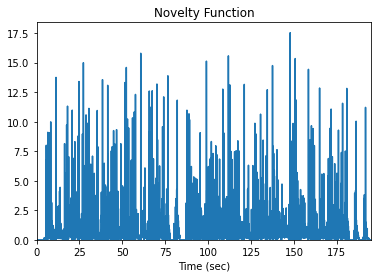

In [43]:
#import seaborn
import numpy, scipy, matplotlib.pyplot as plt

plt.plot(t, onset_env)
plt.xlim(0, t.max())
plt.ylim(0)
plt.xlabel('Time (sec)')
plt.title('Novelty Function')

In [22]:
y_harmonic, y_percussive = librosa.effects.hpss(y)

In [23]:
Audio(data=y_percussive, rate=sr)

In [24]:
Audio(data=y_harmonic, rate=sr)